In [1]:
import pandas as pd 
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import warnings
import math
%matplotlib inline
warnings.filterwarnings('ignore')
from collections import Counter

# Network Analysis - Weltweiter Schiffsverkehr

Github repository: https://github.com/Beniiii/sna_shipTraffic

## Ungerichteter Graph inkl. Betweenness Zentralität
Dieser Plot zeigt das ganze Netzwerk als ungerichteter Graph auf. Die Nodegrösse wird anhand der Betweenness Zentralität bestimmt.

**Analyse:**
Alle Nodes, welche aussen platziert sind und keine Verbindung (roter Strich) zu einem anderen Node haben, visualisieren die Häfen, welche keine Fahrten zu anderen Häfen haben. Das können zum Beispiel Fischerhäfen sein. In der Mitte der Grafik sind die Häfen abgebildet, welche am meisten Verbindungen zu anderen Nodes haben. Grundlegend kann gesagt werden, dass rund die Hälfte aller Häfen nur mit sich oder mit einzelnen anderen Nodes verknüpft sind. Die andere Hälfte dagegen haben Verbindungen zu mehreren anderen Häfen, wobei auch viele der stark verbundenen Häfen eine hohe Betweenness-Zentralität haben. 

In [2]:
df = pd.read_csv("Data/timetable.csv", index_col=[0])

In [3]:
#define nodes
arrival_nodes = df.ArrivalPort.tolist()
departure_nodes = df.DeparturePort.tolist()

nodes = set(np.concatenate((arrival_nodes, departure_nodes)))

In [4]:
#define edges
edges = []
for i in df.index:
    edge = (df['DeparturePort'][i], df['ArrivalPort'][i])
    edges.append(edge)

In [5]:
node_nr = len(nodes)
edge_nr = len(edges)
print("Das gesamte Netzwerk weist", node_nr, "Nodes und", edge_nr, "Edges auf. Die Nodes repräsentieren die Häfen und Edges sind die Fahrten zwischen zwei Häfen.")

Das gesamte Netzwerk weist 3565 Nodes und 98292 Edges auf. Die Nodes repräsentieren die Häfen und Edges sind die Fahrten zwischen zwei Häfen.


In [6]:
#create undirected Graph
graph_undirected = nx.Graph()

graph_undirected.add_nodes_from(nodes)
graph_undirected.add_edges_from(edges)

In [7]:
#calculate betweeness-cantrality
betweenness_centrality = nx.betweenness_centrality(graph_undirected, k=None, normalized=False, weight=None, endpoints=False, seed=None)

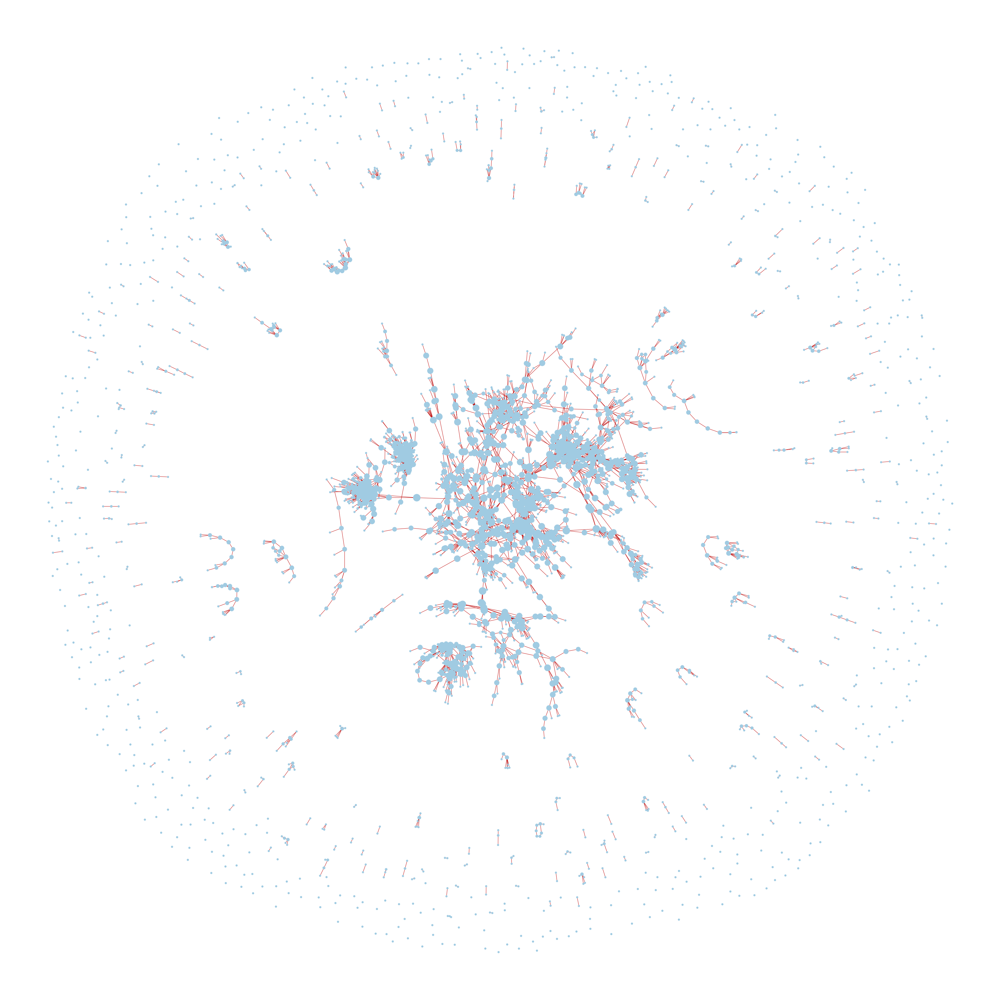

In [8]:
#plot whole network
pos=nx.spring_layout(graph_undirected)
plt.figure(1, figsize=(45,45))

nx.draw(graph_undirected,pos,node_color='#A0CBE2', edges=edges, edge_color='#BB0000',width=1,node_size=[math.log(v+2)*50 for v in betweenness_centrality.values()],font_size=5,with_labels=False)
plt.show()

## Gerichteter Graph
Dieser Plot zeigt das ganze Netzwerk als gerichteter Graph auf. Die Dicke der roten Linie zeigt das Gewicht der Kante an.

**Analyse:**
Im Gegensatz zum ungerichteten Graphen werden Pfeile angezeigt, welche die Fahrtrichtung der Schiffe visualisieren. Je zentraler ein Hafen ist, desto höher ist die Wahrscheinlichkeit, dass die Schiffe in beide Richtungen verkehren. Das gilt auch für das Gewicht der Kanten. Es ist auch erkennbar, dass Schiffe von eher zentralen Häfen nur in eine Richtung zu Häfen fahren, welche aussen positioniert sind. Das können zum Beispiel Insel-Häfen sein, welche hauptsächlich Waren importieren und nichts exportieren, oder solche Häfen, welche nur als Zwischenstopp dienen. Bei Verbindungs-Häfen mit einem hohen Gewicht kann es sich um Passagierschiffe oder Fähren handeln, welche mehrere Mal pro Stunde Hin- und zurück fahren.

In [9]:
#create directed graph with weights
graph_directed = nx.DiGraph((x, y, {'weight': v}) for (x,y), v in Counter(edges).items())
graph_directed.add_nodes_from(nodes)
graph_directed.add_edges_from(edges)

#graph.edges(data = True)

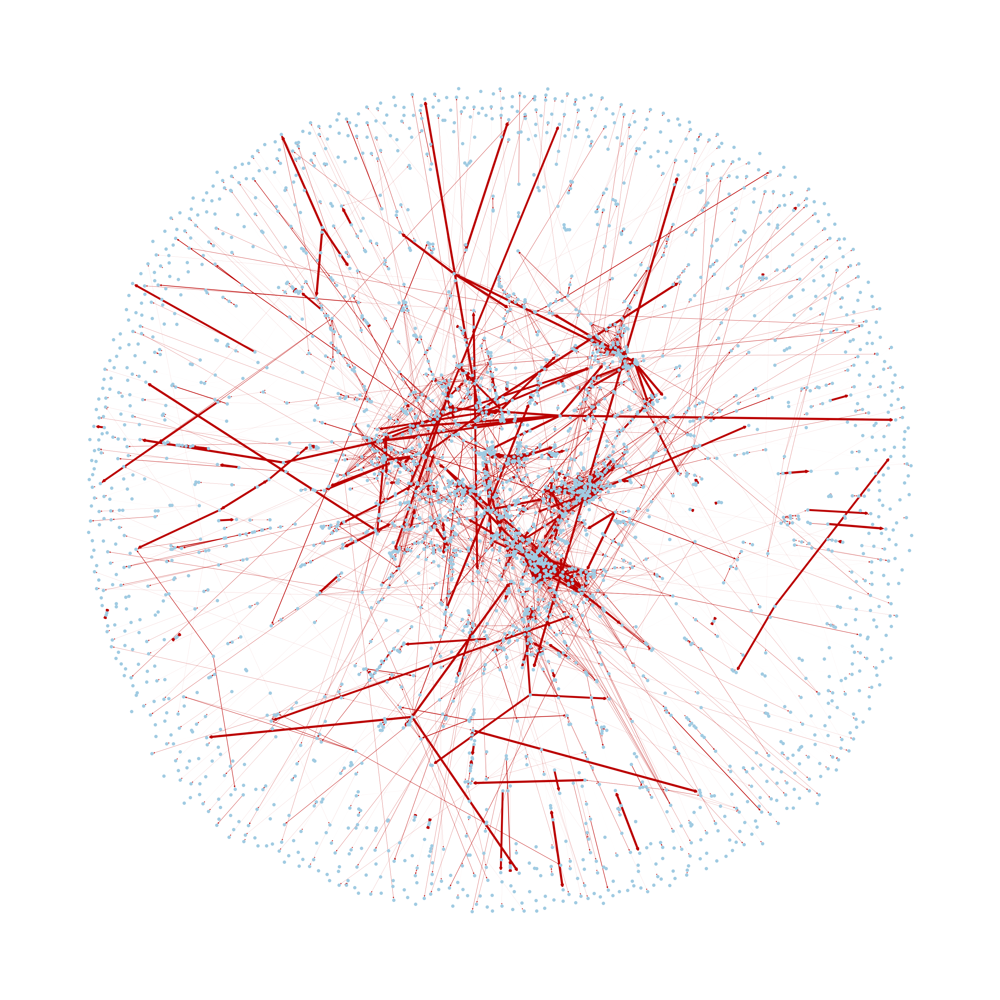

In [10]:
#plot whole network. Without labels
pos=nx.spring_layout(graph_directed)
plt.figure(1, figsize=(45,45))
weights = [graph_directed[u][v]['weight']*0.003 for u,v in edges]

nx.draw(graph_directed,pos,node_color='#A0CBE2',edge_color='#BB0000',width=weights,node_size=100,font_size=5,with_labels = False)
plt.show() 

### Gerichteter Graph mit Labels
Dieser Plot zeigt das ganze Netzwerk als gerichteter Graph auf. Zusätzlich werden die Labels der Häfen angezeigt, welche einen höheren gewichteten Degree als 50 haben.

**Analyse:**
Es wurden nur die Labels der Häfen angezeigt, welche einen hohen gewichteten Degree aufweisen. Sonst wäre der Graph schlicht zu überfüllt und unübersichtlich. Sehr auffällig ist nun, dass die Nodes der stark gewichtete Kanten oft nicht beschriftet sind, was bedeutet, dass diese nicht sehr viele Verbindungen zu anderen Nodes haben. So wird die oben gestellte Hypothese bestätigt, dass solche Verbindungen hauptsächlich von Passagierschiffen oder Fähren befahren werden, welche in einem kleinen Intervall hin- und zurückfahren.
Im Zentrum des Graphs ist ein Cluster von holländischen Häfen wie Rotterdam und Amsterdam zu sehen. Diese Verbindungen führen wahrscheinlich alle durch den Ärmelkanal.

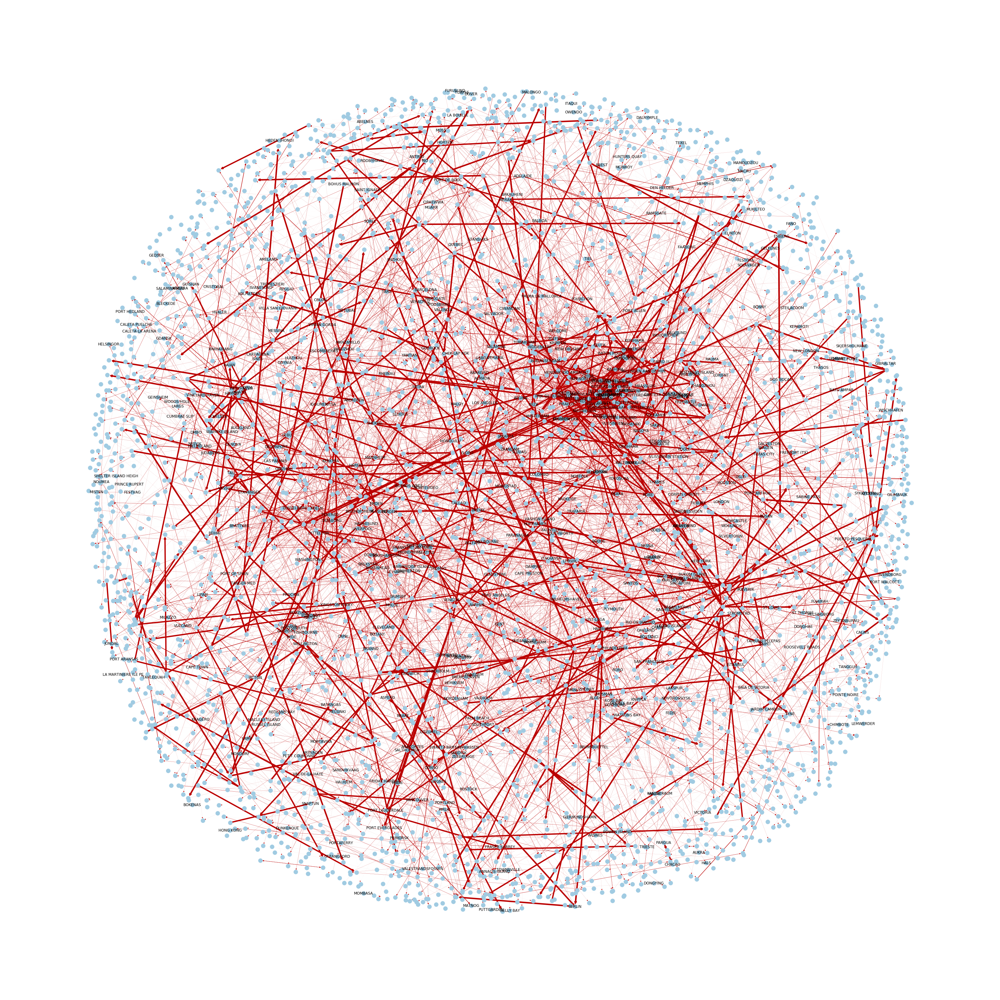

In [11]:
#plot whole network. Ports with most traffic labeled
pos=nx.spring_layout(graph_directed, k = 0.2)
plt.figure(1, figsize=(45,45))
weights = [graph_directed[u][v]['weight']*0.002 for u,v in edges]


weighted_degrees = []
labels = {}

for n in nodes:
    weighted_degree = 0
    for e in graph_directed.edges(n, data = True):
        weighted_degree += e[2].get('weight')
    
    weighted_degrees.append((n,weighted_degree))
    if (weighted_degree > 50):
        labels[n] = n


nx.draw(graph_directed,pos,node_color='#A0CBE2',edge_color='#BB0000',width=weights,node_size=180,font_size=5,with_labels = False)
nx.draw_networkx_labels(graph_directed,pos,labels,font_size=12,font_color='black')
plt.show() 

## Degree Zentralität
### Häfen mit den höchsten Degree Zentralitäten
Dieser Plot zeigt die Verbindungen der Häfen, welche einen höheren Degree als 15 haben.

**Analyse:**
Was beim gerichteten Graph mit Labels bereits erkennt wurde, wird hier nochmals verstärkt, denn der Cluster der holländischen Häfen ist nun besser ersichtlich. Weitere Clusters der Häfen mit hohen Degrees gibt es bei den Häfen in Japan und Deutschland.

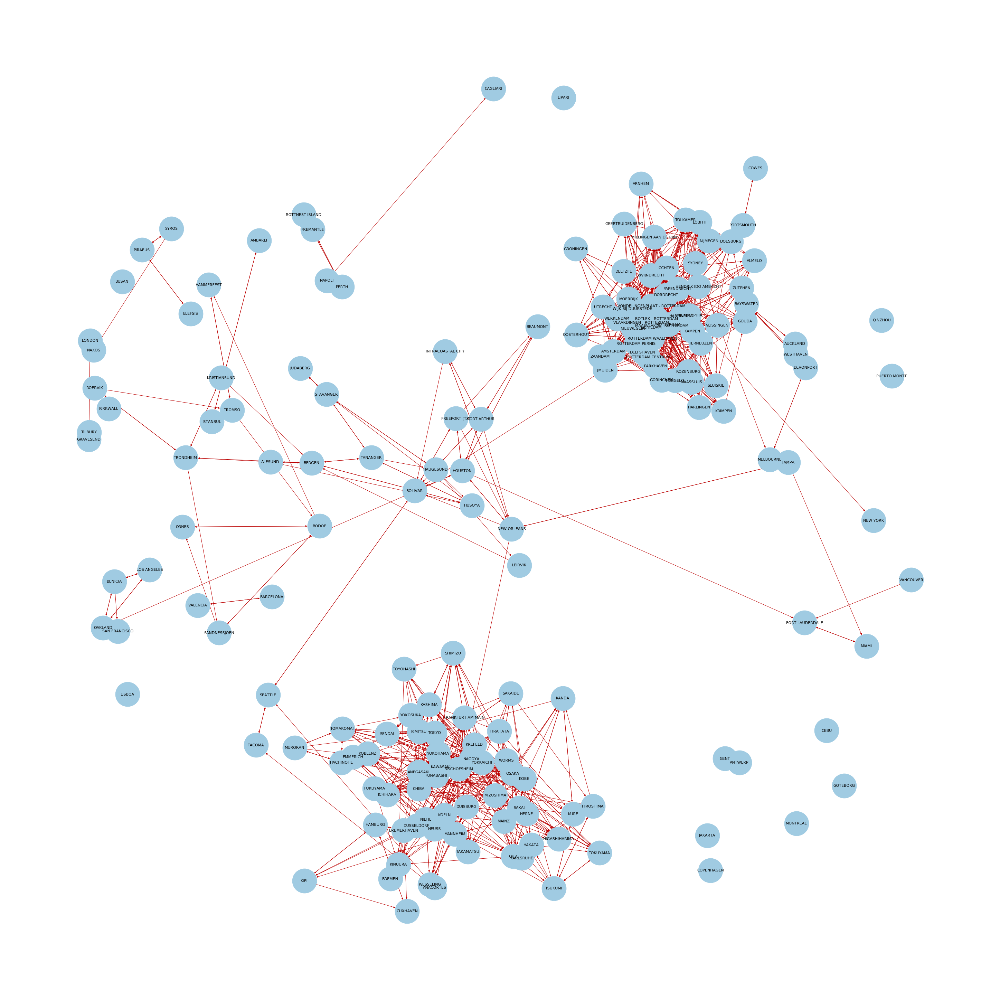

In [12]:
degree = graph_directed.degree()
to_keep = [n for (n, deg) in degree if deg > 15]
graph_filtered_degree = graph_directed.subgraph(to_keep)

pos=nx.spring_layout(graph_filtered_degree, k=0.4)
plt.figure(1, figsize=(40,40))
nx.draw(graph_filtered_degree,pos,node_color='#A0CBE2',edge_color='#BB0000',width=1,node_size=5000,font_size=11,with_labels=True)
plt.show()

### Top 10 Häfen mit den höchsten Degree Zentralitäten
Dieser Bar-Plot zeigt die 10 Häfen auf, welche die höchsten Degree Zentralitäten aufweisen.

**Analyse:**
Bei den Top 10 Häfen, sind 8 von 10 Häfen in Holland platziert. Dies zeigt auf, dass Holland die meisten Verbindungen zu anderen Häfen haben. Spannend ist auch, dass 4 verschiedene Häfen in Rotterdam in den Top 10 Häfen sind. So ist Rotterdam die mächtigste Hafenstadt, gefolgt von Niuwegein.

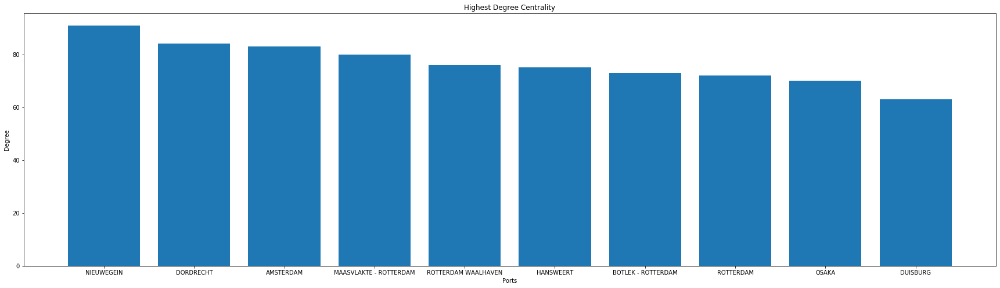

In [13]:
all_degree_centrality = nx.degree_centrality(graph_directed)
centrality_dict = {k: v for k, v in sorted(all_degree_centrality.items(), key=lambda item: item[1])}
highest_centrality_dict = {}

for x in list(reversed(list(centrality_dict)))[0:10]:
    highest_centrality_dict[x] = round(centrality_dict.get(x) * (len(all_degree_centrality) - 1))

#plot barchart    
fig, ax = plt.subplots(figsize=(30, 8))
keys = highest_centrality_dict.keys()
values = highest_centrality_dict.values()
plt.bar(keys, values)
_ = ax.set_title('Highest Degree Centrality')
_ = ax.set_xlabel('Ports')
_ = ax.set_ylabel('Degree')

### Degree Zentralitäts-Verteilung
Dieser Bar-Plot zeigt die Verteilung der Degree-Zentralitäten auf.

**Analyse:**
Der Durschnitt aller Degree-Zentralitäten liegt bei 5.59. Die meiste Degree-Zentralität liegt zwischen 2-4, wo auch der Median liegt. Mehr als 20 Verbindungen haben nur noch wenige Häfen, welche sich aber bis zu einer Degree-Zentralität von 100 ausdehnen.

median 4.0
mean 5.595511921458625


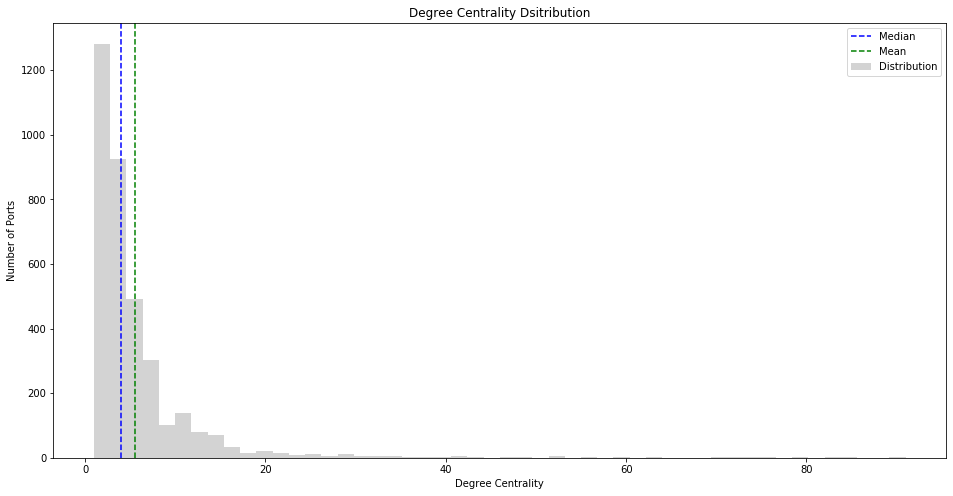

In [14]:
degree_centralities_no_normalized = {}
for x in (list(all_degree_centrality)):
    degree_centralities_no_normalized[x] = all_degree_centrality.get(x) * (len(all_degree_centrality) - 1)
    
median = np.median(list(degree_centralities_no_normalized.values()))
mean = np.mean(list(degree_centralities_no_normalized.values()))
    
fig, ax = plt.subplots(figsize=(16, 8))
_ = ax.hist(degree_centralities_no_normalized.values(), bins=50, label='Distribution', color="lightgray")
_ = plt.axvline(x=median, linestyle='dashed', label='Median', color="blue")
_ = plt.axvline(x=mean, linestyle='dashed', label='Mean', color="green")
_ = ax.set_title('Degree Centrality Dsitribution')
_ = ax.set_ylabel('Number of Ports')
_ = ax.set_xlabel('Degree Centrality')
_ = plt.legend()

print("median", median)
print("mean", mean)

## Meist befahrene Strecken
Dieser Bar-Plot zeigt die meist befahrenen Verbindungen zwischen zwei Häfen.

**Analyse:**
Die meist befahrenen Strecken haben den selben Start- und Endhafen, was auch wieder auf Personenschiffe und Fähren zu führen ist.

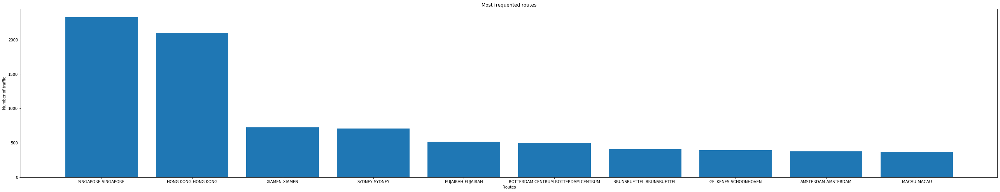

In [15]:
#most frequented routes
weighted_edges = []
frequented_routes_dict = {}

for e in graph_directed.edges(data = True):
    weighted_edges.append((e[0],e[1],e[2].get('weight')))

for x in list(reversed(list(sorted(weighted_edges, key=lambda x: x[2]))))[0:10]:
    connection = x[0] + "-" + x[1]
    frequented_routes_dict[connection] = x[2]
    
    
#plot barchart    
fig, ax = plt.subplots(figsize=(45, 8))
keys = frequented_routes_dict.keys()
values = frequented_routes_dict.values()
plt.bar(keys, values)
_ = ax.set_title('Most frequented routes')
_ = ax.set_xlabel('Routes')
_ = ax.set_ylabel('Number of traffic')  

## Häfen mit den meisten externen Verbindungen
Der Pie-Chart zeigt das Verhältnis zwischen Häfen, welche externe Verbindungen haben mit den Häfen, welche keine externen Verbindungen haben. Der Bar-Plot zeigt die Häfen an, welche am meisten externe Verbindungen haben (ohne self-loops).

**Analyse:**
Mehr als 16% der Häfen sind nicht mit anderen Häfen verbunden und stellen ein eigenen Component dar. Beim Bar-Plot wurden die Top 10 Häfen dargestellt, welche am meisten externe Verbindungen haben, was bedeutet, dass die Self-loops ausgeschlossen wurden. So werden Strecken wie Singapore-Singapore nicht mehr einberechnet, sondern nur solche welche zu einem anderen Hafen führen. Auch hier erkennt man auch wieder die Wichtigkeit der holländischen Häfen.

In [16]:
#define edges withou self-loops
edges_no_self_loop = []
for i in df.index:
    dep = df['DeparturePort'][i]
    arr = df['ArrivalPort'][i]
    
    if (dep != arr):
        edges_no_self_loop.append((dep, arr))

In [17]:
#Create graph
graph_no_loops = nx.DiGraph((x, y, {'weight': v}) for (x,y), v in Counter(edges_no_self_loop).items())

graph_no_loops.add_nodes_from(nodes)
graph_no_loops.add_edges_from(edges_no_self_loop)

In [18]:
#Degree centrality
degree_centrality_no_selfloop = nx.degree_centrality(graph_no_loops)
centrality_dict_no_selfloop = {k: v for k, v in sorted(degree_centrality_no_selfloop.items(), key=lambda item: item[1])}

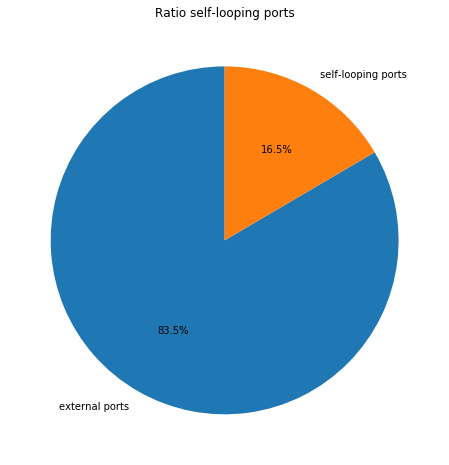

In [19]:
count = sum(map(lambda x : centrality_dict_no_selfloop.get(x) == 0.0, centrality_dict_no_selfloop))

#plot piechart  
fig, ax = plt.subplots(figsize=(45, 8))
labels = "external ports", "self-looping ports"
sizes = [len(centrality_dict_no_selfloop) - count, count]

plt.pie(sizes,labels=labels, autopct='%1.1f%%', shadow=False, startangle=90)
_ = ax.set_title('Ratio self-looping ports')

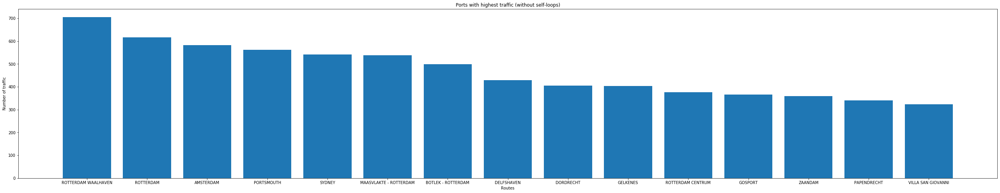

In [20]:
#Ports with highest traffic (without self-loops)
weighted_degrees = []
highest_traffic_noloops_dict = {}

for n in nodes:
    weighted_degree = 0
    for e in graph_no_loops.edges(n, data = True):
        if e is not None:
            weighted_degree += e[2].get('weight')
    
    weighted_degrees.append((n,weighted_degree))


for x in list(reversed(list(sorted(weighted_degrees, key=lambda x: x[1]))))[0:15]:
    highest_traffic_noloops_dict[x[0]] = x[1]
    
    
#plot barchart    
fig, ax = plt.subplots(figsize=(45, 8))
keys = highest_traffic_noloops_dict.keys()
values = highest_traffic_noloops_dict.values()
plt.bar(keys, values)
_ = ax.set_title('Ports with highest traffic (without self-loops)')
_ = ax.set_xlabel('Routes')
_ = ax.set_ylabel('Number of traffic')  

## Ärmelkanal
Geplant war die Analyse der Häfen im Ärmelkanal. Jedoch haben wir ziemlich schnell gemerkt, dass diese keine gute Analyse-Grundlagen mit sich bringen. Die Häfen im Ärmelkanal selber sind gar nicht stark befahren. Wir haben uns aus diesem Grund für die Analyse aller Häfen entschieden und sind dieser Fragenstellung nicht mehr genauer nachgegangen. Unten werden die Anzahl Häfen, zu welchen eine Verbindung besteht, gezählt (Degree-Zentralität). Es ist schnell ersichtlich, dass die Häfen im Ärmelkanal nicht stark verbunden sind.

In [21]:
#https://en.wikipedia.org/wiki/Category:Ports_and_harbours_of_the_English_Channel
english_channel_ports = ['OUISTREHAM', 'BLOSCON', 'CORNWALL','LONGSTONE','MILLBAY','OSTEND','GRANVILLE''DARTMOUTH','DEVON','DIEPPE','BARFLEUR','CORNWALL','FECAMP','FOLKESTONE','FOWEY','BARNEVILLE','BARTERET','CANCALE', 'CHANNEL PORTS', 'CHERBOURG', 'DARTMOUTH', 'ROSCOFF', 'TEIGNMOUTH', 'DOVER', 'CAEN', 'FALMOUTH', 'PORTSMOUTH ANCH', 'PORTLAND UK', 'LE HAVRE', 'SOUTHAMPTON', 'PORTSMOUTH']

counter = 0

for p in centrality_dict_no_selfloop.keys():
    for e in english_channel_ports:
        if e == p:
            counter = counter+1
            print(p, round(centrality_dict_no_selfloop.get(p) * (len(centrality_dict_no_selfloop) - 1)))

ROSCOFF 0
DOVER 0
TEIGNMOUTH 0
FALMOUTH 1
FECAMP 1
CHERBOURG 1
CAEN 2
PORTLAND UK 4
OUISTREHAM 5
PORTSMOUTH ANCH 5
LE HAVRE 10
SOUTHAMPTON 12
PORTSMOUTH 17


In [22]:
print('Es gibt', len(english_channel_ports) - counter, ',in unserem Datensatz nicht gefundenen Häfen, welche einen anderen Namen haben oder keine Verbindung besteht. Man müsste die Daten genauer analysieren.')
print('Auch wurde festgestellt, dass es mehrere Häfen in unterschiedlichen Länder gibt, welche im Datensatz ähnlich benannt wurden: PORTSMOUTH (NH) != PORTSMOUTH ANCH != PORTSMOUTH. Auch diese müsste man separat analysieren.')

Es gibt 17 ,in unserem Datensatz nicht gefundenen Häfen, welche einen anderen Namen haben oder keine Verbindung besteht. Man müsste die Daten genauer analysieren.
Auch wurde festgestellt, dass es mehrere Häfen in unterschiedlichen Länder gibt, welche im Datensatz ähnlich benannt wurden: PORTSMOUTH (NH) != PORTSMOUTH ANCH != PORTSMOUTH. Auch diese müsste man separat analysieren.


## Clusters

In [23]:
avg_clustering_directed = nx.average_clustering(graph_directed)
print("Durchschnittliches Clustering des Netzwerks (gerichtet):", avg_clustering_directed)

avg_clustering_undirected = nx.average_clustering(graph_undirected)
print("Durchschnittliches Clustering des Netzwerks (ungerichtet):", avg_clustering_undirected)

Durchschnittliches Clustering des Netzwerks (gerichtet): 0.1638571363571375
Durchschnittliches Clustering des Netzwerks (ungerichtet): 0.1924660196085192


Diese tiefen Clustering-Werte bedeuten, dass das Netzwerk mehrere Sub-Netzwerke hat, welche nicht miteinander verbunden sind oder Häfen, welche nicht in Verbindung mit anderen stehen.

### Clustering Verteilung
Die Histogramme zeigen die Verteilung der Clusterings von gerichteten und ungerichteten Graphen auf.

**Analyse:**
Ein grosser Anteil der Häfen gehört zu keinen oder sehr wenigen Clusters. Diese Verteilung variiert ziemlich stark. Es ist auch ersichtlich, dass es doch ca. 200 Häfen gibt, welche sehr stark vernetzt sind. Die beiden Graphen unterscheiden sich nur minim.

In [24]:
print("Durchschnitts-Clustering:", avg_clustering_directed)

Durchschnitts-Clustering: 0.1638571363571375


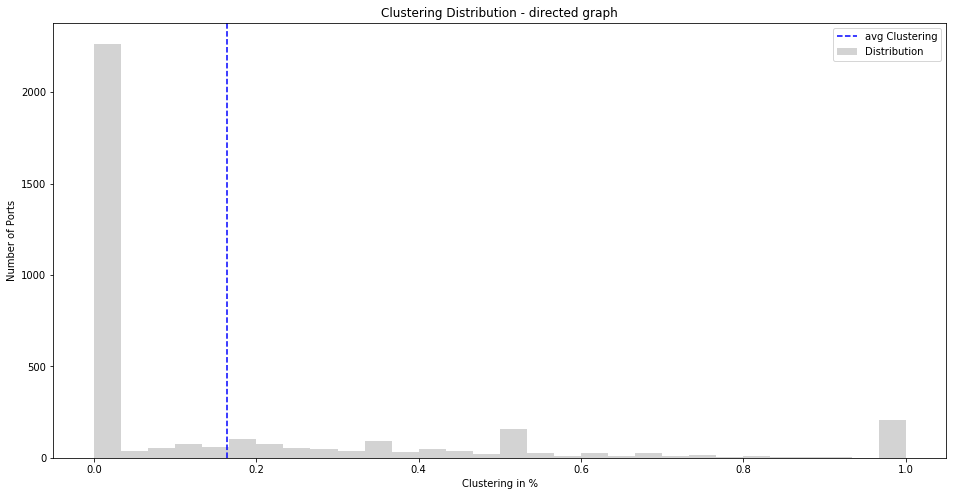

In [25]:
all_clusterings_directed = nx.clustering(graph_directed)
    
fig, ax = plt.subplots(figsize=(16, 8))
_ = ax.hist(all_clusterings_directed.values(), bins=30, label='Distribution', color="lightgray")
_ = plt.axvline(x=avg_clustering_directed, linestyle='dashed', label='avg Clustering', color="blue")
_ = ax.set_title('Clustering Distribution - directed graph')
_ = ax.set_ylabel('Number of Ports')
_ = ax.set_xlabel('Clustering in %')
_ = plt.legend()  

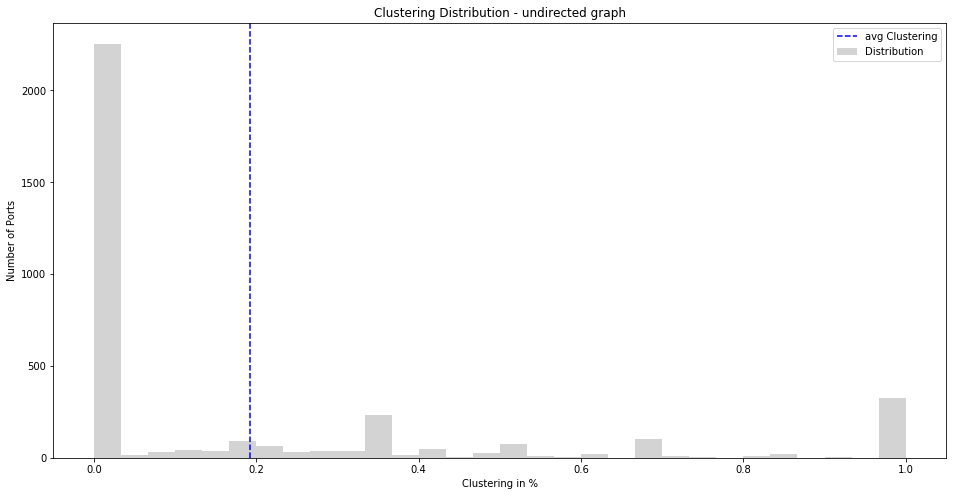

In [26]:
all_clusterings_undirected = nx.clustering(graph_undirected)
    
fig, ax = plt.subplots(figsize=(16, 8))
_ = ax.hist(all_clusterings_undirected.values(), bins=30, label='Distribution', color="lightgray")
_ = plt.axvline(x=avg_clustering_undirected, linestyle='dashed', label='avg Clustering', color="blue")
_ = ax.set_title('Clustering Distribution - undirected graph')
_ = ax.set_ylabel('Number of Ports')
_ = ax.set_xlabel('Clustering in %')
_ = plt.legend()  

## Components

In [27]:
print('Anzahl der unterschiedlichen Components:', nx.number_connected_components(graph_undirected)) 

Anzahl der unterschiedlichen Components: 876


### Grössten Components
Das Netzwerk visualisiert die Components, welche mehr als 100 verbundene Nodes besitzen.

**Analyse:**
Da es eine grosse Anzahl Components gibt, sind viele Häfen nur von gewissen Häfen erreichbar und völlig abgeschottet von anderen Components. Das heisst, dass Häfen von anderen Components nicht erreichbar sind. Der grösste Component beinhaltet 759 Häfen, der 5. grösste jedoch nur noch 121. Alle anderen umfassen weniger als 100 Nodes, was bedeutet, dass es viele Häfen in sehr kleinen Components gibt. Diese Aussage passt auch zu deren vom ersten Graph.

size red component:  150
size green component:  448
size magenta component:  121
size cyan component:  759
size blue component:  174


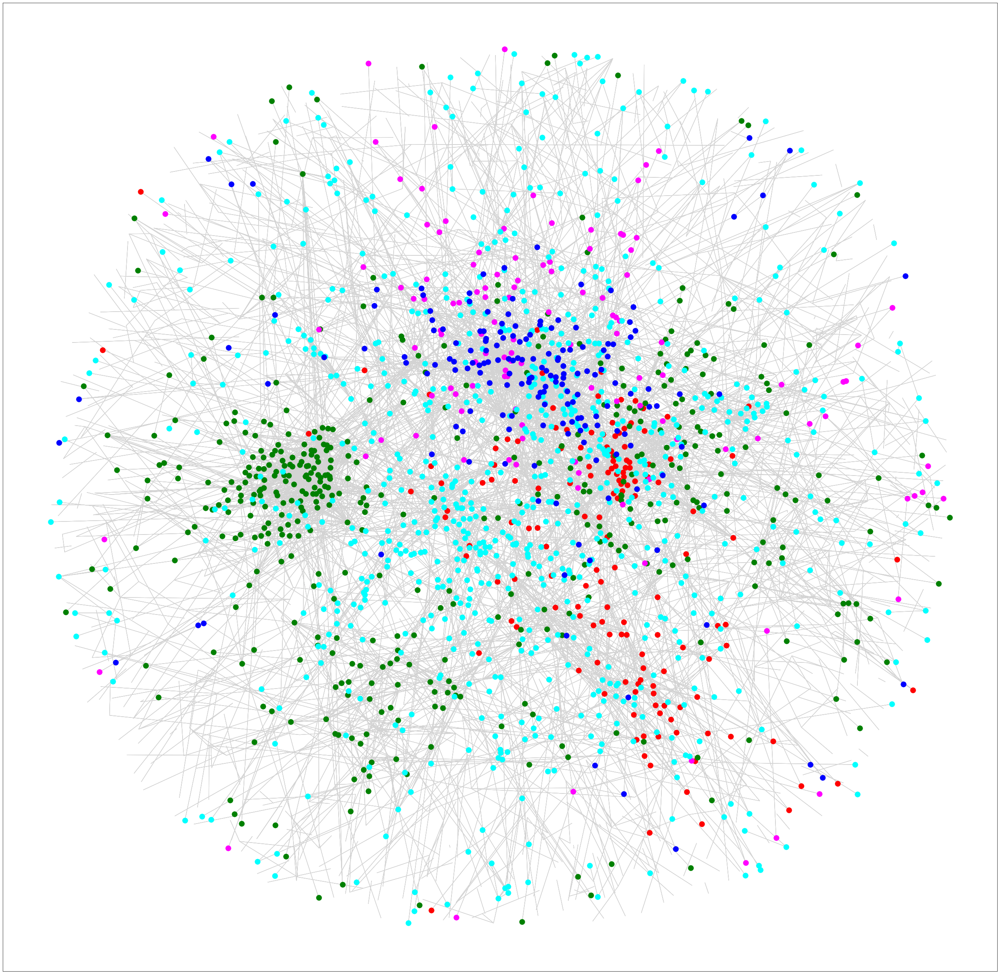

In [28]:
connected_component_list = list(nx.connected_components(graph_undirected))
filtered_coponent_list = []
for x in connected_component_list:
    if len(x) > 100:
        filtered_coponent_list.append(list(x))
     
        
pos=nx.spring_layout(graph_directed, k = 0.08)
plt.figure(1, figsize=(45,45))
colorlist = [ 'red', 'green', 'magenta', 'cyan', 'blue']
for i, val in enumerate(filtered_coponent_list):
    print("size", colorlist[i], "component: ", len(val))
    nx.draw_networkx(graph_undirected, nodelist = val, pos = pos, node_size = 180, node_color = colorlist[i], edge_color = "#d3d3d3", with_labels = False)

Nun ist auch ziemlich klar, dass der Graph weder stark nach schwach verbunden ist:

In [29]:
print("Ist der Graph Strongly Connected?", nx.is_strongly_connected(graph_directed))
print("Ist der Graph Weakly Connected?", nx.is_weakly_connected(graph_directed))

Ist der Graph Strongly Connected? False
Ist der Graph Weakly Connected? False


## Kürzeste Wege
Die kürzesten Wege kann mit NetworkX einfach herausgefunden werden. Dabei werden hier zufällige Häfen ausgewählt und den Weg sowie die Anzahl der Hops gezeigt. Er ist erstaunlich, dass es keine direkteren Wege von Miami nach Melbourne gibt. Mit den vorhandenen Daten (von 3 Tagen) wäre ein Zwischenstopp in England nötig. Auch kann man sehen, dass es bei gewissen Ländern einen "Haupthafen" gibt, welche Schiffe oft zuerst anfahren. Das wäre nun in diesem Beispiel von Australien der Hafen Brisbane.

In [30]:
print("Weg:", nx.shortest_path(graph_directed, 'KETAPANG', 'GILIMANUK')) 
print("Anzahl Hops:", nx.shortest_path_length(graph_directed, 'KETAPANG', 'GILIMANUK'))
print()
print("Weg:",nx.shortest_path(graph_directed, 'MIAMI', 'MELBOURNE')) 
print("Anzahl Hops:",nx.shortest_path_length(graph_directed, 'MIAMI', 'MELBOURNE'))
print()
print("Weg:",nx.shortest_path(graph_directed, 'MIAMI', 'SYDNEY')) 
print("Anzahl Hops:",nx.shortest_path_length(graph_directed, 'MIAMI', 'SYDNEY'))

Weg: ['KETAPANG', 'GILIMANUK']
Anzahl Hops: 1

Weg: ['MIAMI', 'FORT LAUDERDALE', 'WILMINGTON', 'SOUTHPORT', 'BRISBANE', 'BOTANY', 'MELBOURNE']
Anzahl Hops: 6

Weg: ['MIAMI', 'FORT LAUDERDALE', 'WILMINGTON', 'SOUTHPORT', 'BRISBANE', 'SYDNEY']
Anzahl Hops: 5


## Betweenness Zentralität
Die Betweenness-Zentralität wurde bereits im ersten Graph visualisiert. Hier wird zusätzlich ein Bar-Plot angezeigt, welche die grössten Betweenness Zentralität haben.

**Analyse:**
Ein hoher Betweenness-Zentralitätswert bedeutet, dass viele Häfen von einem Port mit dem hohen Betweenness-Wert abhängig sind. Wenn der Hafen nicht mehr angefahren wird, sind viele andere auch nicht mehr erreichbar. Wir haben den Hafen Port of Spain, welcher in Trinidad and Tobago liegt genauer untersucht. Es handelt sich hier um einen Inselstaat in der Karibik. Obwohl die Insel nur etwa 1/8 der Fläche von der Schweiz umfasst, verkehren viele Schiffe über diesen Hafen. Die Güter werden dann intern auf die Inseln der Karibik verteilt.

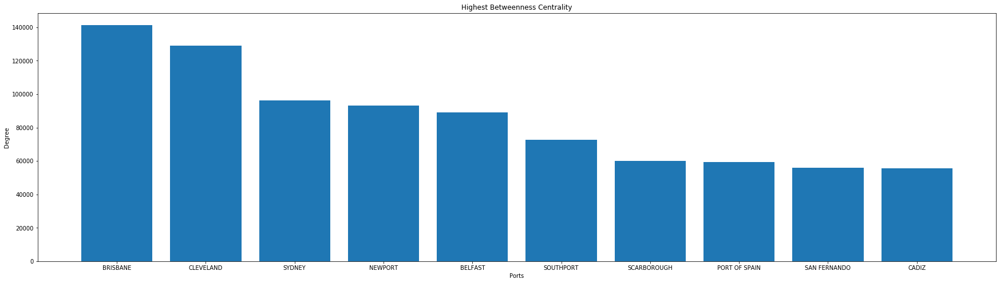

In [31]:
bet_centrality_dict = {k: v for k, v in sorted(betweenness_centrality.items(), key=lambda item: item[1])}
highest_bet_centrality_dict = {}

for x in list(reversed(list(bet_centrality_dict)))[0:10]:
    highest_bet_centrality_dict[x] = betweenness_centrality.get(x)

fig, ax = plt.subplots(figsize=(30, 8))
keys = highest_bet_centrality_dict.keys()
values = highest_bet_centrality_dict.values()
plt.bar(keys, values)
_ = ax.set_title('Highest Betweenness Centrality')
_ = ax.set_xlabel('Ports')
_ = ax.set_ylabel('Degree')

## Bridges
Das Netzwerk visualisiert die verschiedenen Bridges, welche violet eingefärbt sind. Edges, welche keine Bridge werden schwarz angezeigt. 

**Analyse:**
Erstaunlich ist, dass es viele Components gibt, welche nur aus Bridges bestehen. Das heisst, dass diese Components untereinander nicht stark vernetzt sind, sondern jede weitere Verbindung von nur einem einzigen Hafen abhängt. Es ist ca. jede 6. Edge eine Bridge, was uns als eher hoch erscheint. 

In [32]:
bridges = nx.bridges(graph_undirected)
bridges_copy = nx.bridges(graph_undirected)

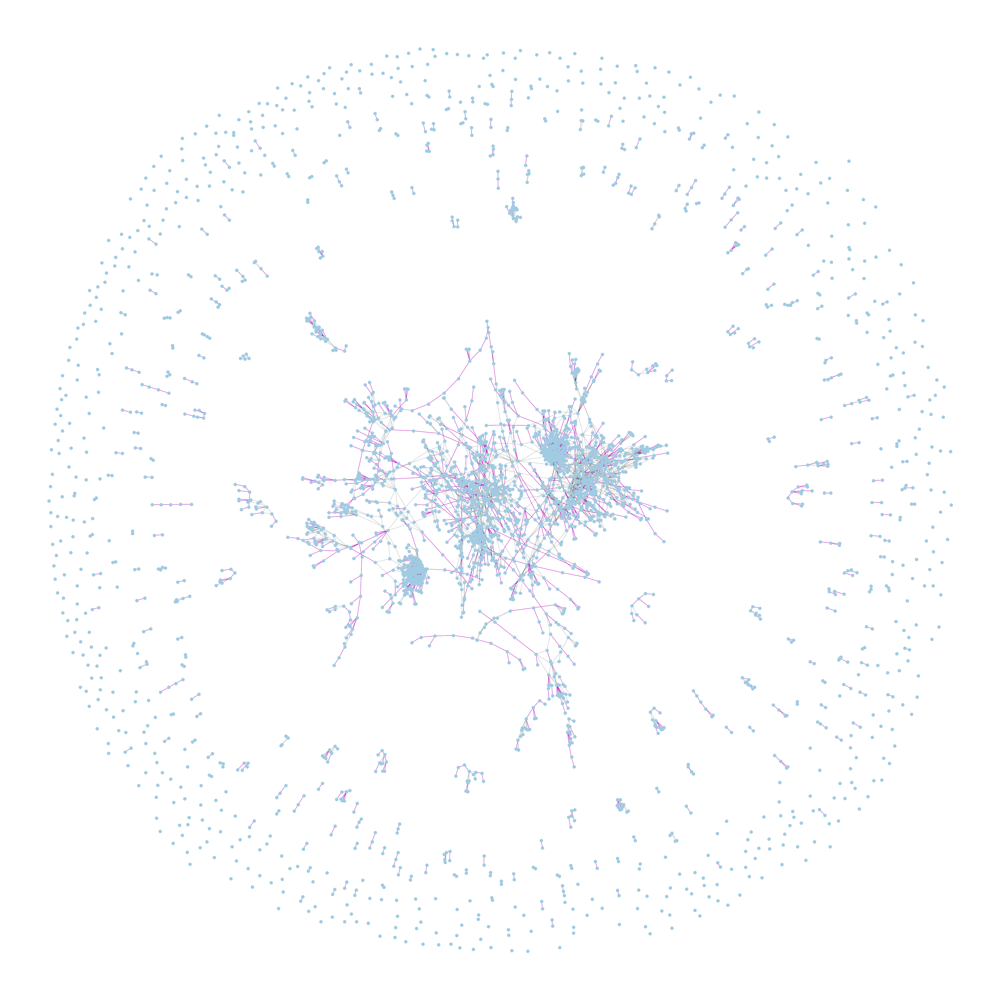

In [33]:
pos=nx.spring_layout(graph_undirected)
plt.figure(1, figsize=(45,45))
#weights = [graph_undirected[u][v]['weight']*0.005 for u,v in edges]
nx.draw(graph_undirected,pos,node_color='#A0CBE2',edges=edges, alpha=0.3, edge_color='#000000',width=1,node_size=100,font_size=5,with_labels=False)

graph_bridges=nx.Graph()
graph_bridges.add_nodes_from(graph_undirected)
graph_bridges.add_edges_from(bridges)

nx.draw(graph_bridges,pos,node_color='#A0CBE2', alpha=1, edge_color='#C816D1',width=1,node_size=100,font_size=5,with_labels=False)
plt.show()

In [34]:
print("Bridges-Anteil in Prozent:" ,len(graph_bridges.edges())/len(graph_undirected.edges())*100, "%")

Bridges-Anteil in Prozent: 15.58559729624334 %


## Schiffstypen

In [35]:
arrival_nodes = df.ArrivalPort.tolist()
departure_nodes = df.DeparturePort.tolist()

nodes = set(np.concatenate((arrival_nodes, departure_nodes)))

In [36]:
G = nx.Graph()
G.add_nodes_from(nodes)
for i in df.index:
    G.add_edge(df['DeparturePort'][i], df['ArrivalPort'][i], vesselType=df['VesselType'][i]) 

In [37]:
a = highest_traffic_noloops_dict.keys()
ship_df = df[df['DeparturePort'].isin(a) | df['ArrivalPort'].isin(a)]
arrival_df = df[df['ArrivalPort'].isin(a)]

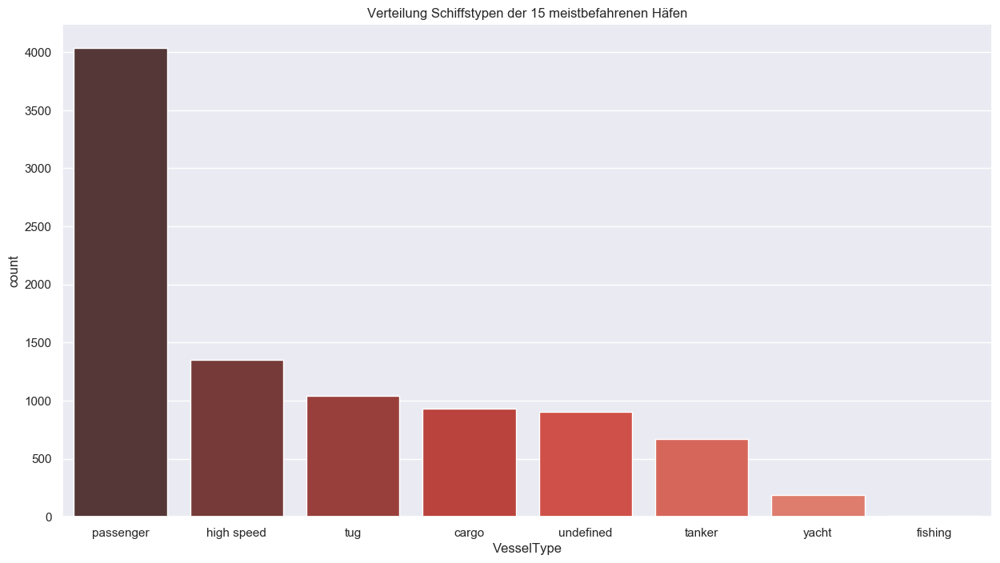

In [44]:
sns.set(style="darkgrid")
fig, ax = plt.subplots(figsize=(15,8))
sns.countplot(x="VesselType", data=arrival_df, palette='Reds_d', order = arrival_df['VesselType'].value_counts().index)
plt.title('Verteilung Schiffstypen der 15 meistbefahrenen Häfen')
plt.show()

Der Plot zeigt, die Verteilung der Schiffstypen in den 15 meist befahrenen Häfen auf. Es ist auffällig, dass fast die Hälfte dabei Personen transportieren.

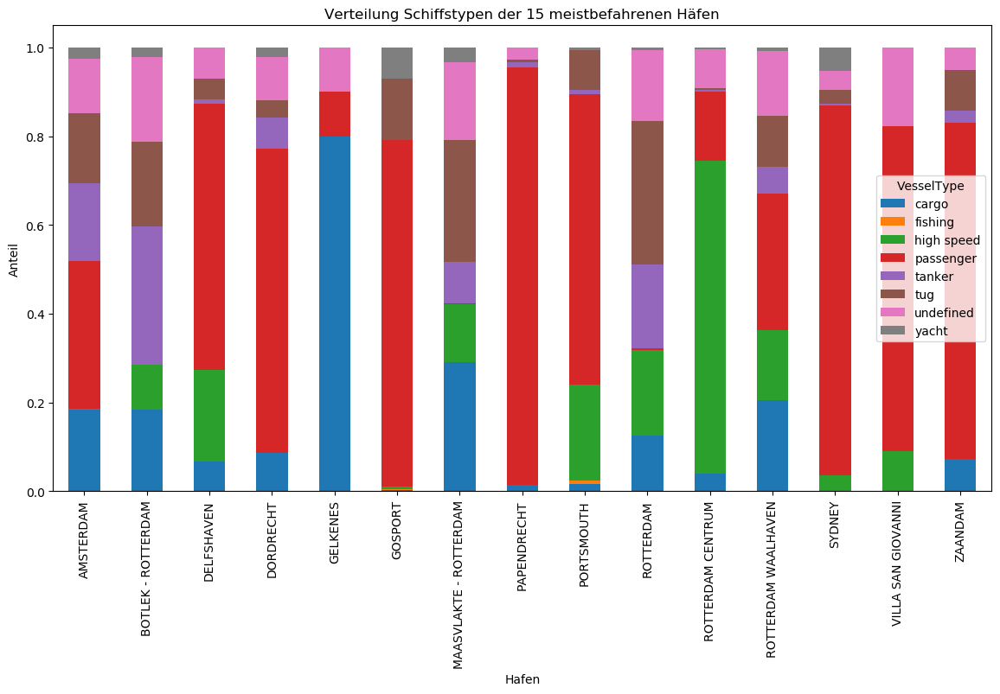

In [45]:
plt.style.use('default')
p_table = pd.pivot_table(arrival_df, index="ArrivalPort", columns="VesselType", aggfunc='size')
p_table = p_table.div(p_table.sum(axis=1), axis=0)
p_table.plot.bar(stacked=True, figsize=(14,7))
plt.xlabel('Hafen')
plt.ylabel('Anteil')
plt.title('Verteilung Schiffstypen der 15 meistbefahrenen Häfen')
plt.show()

Der Plot zeigt, wie die Verteilung der Ankünfte der Schiffstypen auf die verschiedenen der 15 meist befahrenen Häfen ist. Cargo Schiffe gibt es vor allem in Gelkenes, aber auch viele in den verschiedenen Häfen von Rotterdam und Amsterdam wo ausserdem ein Grossteil der Tanker anlegen. Viele Ankünfte mit Passagieren gibt es in Delfshaven, Dordrech, Gosport, Papendrecht, Portsmouth, Sydney, Villa San Giovanni und Zaandam, wobei einige Häfen fast ausschliesslich von Passagierschiffen befahren werden. Rotterdam Centrum beherbergt vor allem High Speed Boote. Die Fischerboote sind vor allem in Portsmouth unterwegs.

# Lessons Learned & Ausblick
- Das Einarbeiten in NetworkX hat uns am Anfang viel Zeit gekostet. Nach den ersten Plots wurde uns aber klar, wie man die Library benutzt muss. Die Dokumentation ist sehr umfangreich und hat uns dank den Beispielen sehr geholfen.
- Da wir mit einer sehr grossen Datenmenge arbeiten, ist die Wartezeit der Erstellung eines Graphens zum Teil eher lange.
- Leider konnten wir die Daten nicht wirklich Filtern, da wir die Geodaten oder Länder der Häfen nicht zur Verfügung hatten. Im nächsten Schritt würden wir probieren die Länder mit den Häfen mit Hilfe eines zusätzlichen Datensatzes zu mappen, um länderspezifische Analysen zu machen.